# Study of the Effectiveness of Load Imbalance Metrics in Parallel Applications

## Introduction

### Goal

[comment]: # (Explain goal - or goals - of this report)
The purpose of this notebook is to investigate the effectiveness of existing load imbalance metrics as descriptors of load distribution among processors in a parallel linear algebra application written for the [`StarPU`](http://starpu.gforge.inria.fr) runtime. 

The examination will consider the evolution of load distribution and the metrics - how they progress over time. More specifically, two different aspects will be analyzed for each of the metrics selected as part of the study. First, the metrics coherence...

### Metrics

[comment]: # (Introduce the general concept of a load imbalance metric)
[comment]: # (List all metrics under study)
A load imbalance metric attempts to quantify and, thus, describe some aspect of the workload distribution across computation members (i.e. threads, processes or machines) in a parallel application. The metrics that will be analyzed are:

* _Standard Deviation_
* _Skewness_
* _Kurtosis_
* _Percent Imbalance_
* _Imbalance Percentage_
* _Imbalance Time_

[comment]: # (Point to where an explanation on these metrics can be found)

### Data

#### `MPI`

#### `OpenMP`

#### `StarPU`

[comment]: # (Describe data)
[comment]: # (Briefly describe StarPU)
As written in the goal section above, the data analyzed in this notebook comes from the execution of a linear algebra application written for the `StarPU` runtime. [`StarPU`](http://onlinelibrary.wiley.com/doi/10.1002/cpe.1631/full) is a task-based API and runtime. The programmer of a `StarPU` application is expected to provide tasks implementations for the architectures available in the execution infrastructure (e.g. CPU, GPU) and a description of the constraints between those tasks (i.e. ordering impositions). The runtime time is charged with handling task dependencies, scheduling, and data transfers. The `StarPU` version used to generate the traces used here was the 4th release candidate of version 1.2.0 ([Download 1.2.0rc4](http://starpu.gforge.inria.fr/files/starpu-1.2.0rc4.tar.gz)).

[comment]: # (Discuss the application - cholesky - as well as the input size for which it was executed - 20k)
[comment]: # (List and describe the parameters that were modified - scheduler and block size)
The application for which the examination will be performed consists of an implementation of the `Cholesky` decomposition - distributed, as a benchmark, within [the official StarPU codebase](http://starpu.gforge.inria.fr/doc/html/BuildingAndInstallingStarPU.html#CholeskyFactorization). 

The `cholesky` benchmark has, among others, two optional arguments: the size of matrix for which the factorization should be performed (`-size`) and the size of the blocks (`-nblocks`) into which the input will be partitioned. Both arguments expect a single integer that describes a square matrix (e.g. `-size 5000` indicates a `5000`x`5000` input matrix and `-nblocks 100` defines that the matrix should be divided in `100x100` elements). The input size used in the experiments analyzed here was a `20000` x `20000` matrix. Two different block sizes were experimented with: `20`x`20` and `80`x`80`.

Another parameter that was modified during experiments was the task scheduler - controlled via the `STARPU_SCHED` environment variable. [Multiple schedulers](http://starpu.gforge.inria.fr/doc/html/Scheduling.html) are available to be employed by the runtime. For these experiments, two were used: `DMDA` and `DMDAS`.

[comment]: # (Wrap up listing factor combinations)
Hence, summarizing exactly what data will be looked into, one runtime (`StarPU`), one application (`Cholesky` decomposition), one input matrix size (`20000`x`20000`), two block sizes for partitioning the input matrix (`20`x`20` & `80`x`80`), and two `StarPU` task schedulers (`DMDA` & `DMDAS`) were used in a full-factorial experimental design. Such design, thus, originated the following factor combinations:
* `StarPU`, `Cholesky`, `20000`x`20000`, `20`x`20`, and `DMDA`.
* `StarPU`, `Cholesky`, `20000`x`20000`, `80`x`80`, and `DMDAS`.
* `StarPU`, `Cholesky`, `20000`x`20000`, `20`x`20`, and `DMDA`.
* `StarPU`, `Cholesky`, `20000`x`20000`, `80`x`80`, and `DMDAS`.

### Execution Environment

[comment]: # (Describe machine - turing - where experiments were executed)
The execution of the experiments was performed in the [`turing`](http://www.inf.ufrgs.br/gppd/gppd/?q=en/node/63) machine. `Turing` is a single node machine containing four Intel Xeon X7550 processors. Each of these processors has 8 cores. Hence, `turing` has a total of 32 cores as well as 128 GB of main memory. Trace data used here is located in `lfs/03`.

### Methodology

[comment]: # (How the metrics are evaluated?)
[comment]: # (What is load?)

#### `MPI`

#### `OpenMP`

#### `StarPU`

## Analysis

In [1]:
using DataFrames
using Gadfly
using YAJP

### Loading Data

[comment]: # (Below the executions selected as the most representative are loaded)
[comment]: # (Briefly explain data structure that holds traces)

#### `MPI`

In [2]:
mpi = Dict{AbstractString, YAJP.Trace}()
for execution in ["blocking", "non-blocking", "phase", "no-phase"]
    mpi[execution] = trace("lfs/01/$(execution)/paje.csv", "conf/yajp/01/MPI.yaml")
end

#### `OpenMP`

#### `StarPU`

In [6]:
starpu = Dict{ByteString, Dict{Int,YAJP.Trace}}()
for scheduler in ["DMDA", "DMDAS"]
    starpu[scheduler] = Dict{ByteString,YAJP.Trace}()     
end

In [4]:
function starpu_performance(scheduler::ByteString, bsize::Int)
    # assert parameters
    @assert scheduler in ["DMDA", "DMDAS"] "Invalid scheduler (DMDA, DMDAS)"
    @assert bsize in [20, 80] "Invalid block size (20, 80)"
    # get runtime for every run
    spans = Float64[]
    for r in 1:10
        if r != 10
            t = trace("lfs/03/turing.cholesky.20K/$(lowercase(scheduler))/$(bsize)/0$(r)/paje.csv", 
                      "conf/yajp/03/StarPU.yaml")
        else
            t = trace("lfs/03/turing.cholesky.20K/$(lowercase(scheduler))/$(bsize)/$(r)/paje.csv", 
                      "conf/yajp/03/StarPU.yaml")
        end
        push!(spans, YAJP.span(t))
    end
    # plot span for every run next to mean span
    plot(layer(yintercept=[mean(spans)-std(spans), mean(spans), mean(spans)+std(spans)], 
        Geom.hline(color="grey", size=0.035cm)),
        layer(x=range(1,10), y=spans, color=range(1,10), 
        Geom.bar(position=:dodge)), 
        Scale.x_discrete,
        Guide.xlabel("Run", orientation=:horizontal), 
        Guide.ylabel("Span (s)", orientation=:vertical),
        Guide.title("Performance for Every $(scheduler)/$(bsize) Run"),
        Theme(bar_spacing=3pt, key_position=:none))
end

starpu_performance (generic function with 1 method)

**Scheduler** `DMDA`, **Block Size** `20`

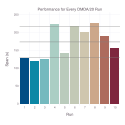

In [7]:
# set parameters
scheduler = "DMDA"
bsize = 20
# set plot size
set_default_plot_size(12.5cm, 12.5cm)
# plot performance for all runs
starpu_performance(scheduler, bsize)

In [11]:
starpu["DMDA"][20] = trace("lfs/03/turing.cholesky.20K/dmda/20/09/paje.csv", "conf/yajp/03/StarPU.yaml")

Trace holding 32 Containers, 15896 kept Events, and 0 discarded Events.

**Scheduler** `DMDA`, **Block Size** `80`

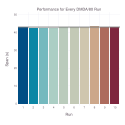

In [10]:
# set parameters
scheduler = "DMDA"
bsize = 80
# set plot size
set_default_plot_size(12.5cm, 12.5cm)
# plot performance for all runs
starpu_performance(scheduler, bsize)

In [12]:
starpu["DMDA"][80] = trace("lfs/03/turing.cholesky.20K/dmda/80/09/paje.csv", "conf/yajp/03/StarPU.yaml")

Trace holding 32 Containers, 892096 kept Events, and 0 discarded Events.

**Scheduler** `DMDAS`, **Block Size** `20`

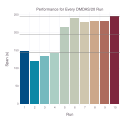

In [9]:
# set parameters
scheduler = "DMDAS"
bsize = 20
# set plot size
set_default_plot_size(12.5cm, 12.5cm)
# plot performance for all runs
starpu_performance(scheduler, bsize)

In [13]:
starpu["DMDAS"][20] = trace("lfs/03/turing.cholesky.20K/dmdas/20/05/paje.csv", "conf/yajp/03/StarPU.yaml")

Trace holding 32 Containers, 15896 kept Events, and 0 discarded Events.

**Scheduler** `DMDAS`, **Block Size** `80`

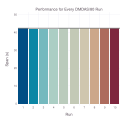

In [8]:
# set parameters
scheduler = "DMDAS"
bsize = 80
# set plot size
set_default_plot_size(12.5cm, 12.5cm)
# plot performance for all runs
starpu_performance(scheduler, bsize)

In [14]:
starpu["DMDAS"][80] = trace("lfs/03/turing.cholesky.20K/dmdas/80/07/paje.csv", "conf/yajp/03/StarPU.yaml")

Trace holding 32 Containers, 892096 kept Events, and 0 discarded Events.

### Load Imbalance

In [255]:
function load_heatmap(tr::YAJP.Trace, timestep::Int, xinfo::Bool=true)
    # get loads
    lds = loads(tr, timestep)
    try
        lds = sort!(lds, 
                    cols = order(:container, by = x -> parse(Int, replace(x, "rank", ""))),
                    rev = true)
    catch e
        if isa(e, ArgumentError)
            lds = sort!(lds, 
                    cols = order(:container, by = x -> parse(Int, replace(x, "CPU", ""))),
                    rev = true)
        end
    end
    # define xticks step
    stp = convert(Int, round(YAJP.span(tr)/20))
    # plot heat map of load evolution per resource
    p = plot(lds, x="midpoint", y="container", color="normalized", Geom.rectbin,
        Coord.cartesian(xmin=YAJP.began(tr), xmax=YAJP.ended(tr)),
        Guide.xticks(ticks=collect(YAJP.began(tr):stp:YAJP.ended(tr))),
        Scale.x_continuous(labels = x -> string(convert(Int, floor(x)))),
        Scale.color_continuous(minvalue=0.0, maxvalue=1.0),
        Guide.xlabel("Time (s)"),
        Guide.ylabel("Resource"),
        Guide.title("Normalized Load per Resource at Every $(convert(Int, timestep)) s"),
        Guide.colorkey("Load"),
        Theme(guide_title_position=:center))
    return p
end

load_heatmap (generic function with 2 methods)

In [256]:
function metric_heatmap(tr::YAJP.Trace, f::Function, timestep::Int, drop::Int=0)
    # retrieve metric
    mtr = metrics(tr, f, timestep, drop)
    # define xticks step
    stp = convert(Int, round(YAJP.span(tr)/20))
    # select appropriate metric y-label and title start
    if f == std
        text = "Standard Deviation (s)"
    elseif f == skewness
        text = "Skewness"
    elseif f == kurtosis
        text = "Kurtosis"
    elseif f == pimbalance
        text = "Percent Imbalance"
    elseif f == imbalancep
        text = "Imbalance Percentage"
    else
        text = "Imbalance Time (s)"
    end
    # plot metric heat map
    p = plot(mtr, x="midpoint", y="metric", color="value", Geom.rectbin,
        Coord.cartesian(xmin=YAJP.began(tr)+drop, xmax=YAJP.ended(tr)-drop),
        Guide.xticks(ticks=collect(YAJP.began(tr)+drop:stp:YAJP.ended(tr)-drop)),
        Scale.x_continuous(labels = x -> string(convert(Int, floor(x)))),
        Guide.xlabel("Time (s)"),
        Scale.y_discrete(labels= x->""),
        Guide.ylabel("$(text)", orientation=:vertical),
        Scale.color_continuous(minvalue=minimum(mtr[:value]), maxvalue=maximum(mtr[:value])),
        Guide.colorkey("Value"),
        Guide.title("$(replace(text, " (s)", "")) Evolution at Every $(convert(Int, timestep)) s"),
        Theme(guide_title_position=:left))
    return p
end

metric_heatmap (generic function with 3 methods)

#### Metrics: Coherence

In [257]:
# metrics under study
fs = [std, skewness, kurtosis, pimbalance, imbalancep, imbalancet];

##### `MPI`

In [258]:
# evolution grain
timestep = 1;

**Blocking**

In [259]:
# define parameters
execution = "blocking";

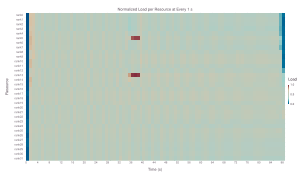

In [260]:
# define size of plot
set_default_plot_size(30cm, 18cm)
# plot heat map of load evolution per resource
load_heatmap(mpi[execution], timestep)

In [261]:
# define how much time (at each end of exec) must be dropped
drop = 2;

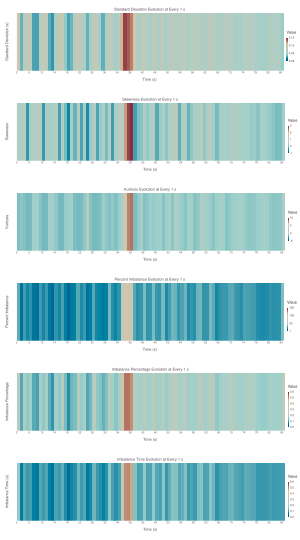

In [262]:
# plots container
plots = Plot[]

# plot metrics heat maps
for f in fs
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end

# define plot size
set_default_plot_size(30cm, length(fs)*9cm)

# draw plots vertically
vstack(plots)

**Non-blocking**

In [263]:
# define parameters
execution = "non-blocking";

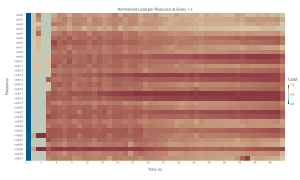

In [264]:
# define size of plot
set_default_plot_size(30cm, 18cm)
# plot heat map of load evolution per resource
load_heatmap(mpi[execution], timestep)

In [265]:
# define how much time (at each end of exec) must be dropped
drop = 1;

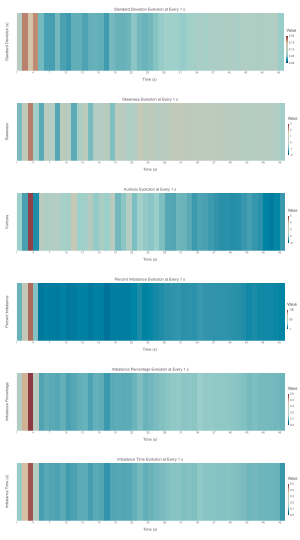

In [266]:
# plots container
plots = Plot[]

# plot metrics heat maps
for f in fs
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end

# define plot size
set_default_plot_size(30cm, length(fs)*9cm)

# draw plots vertically
vstack(plots)

**Phase**

In [267]:
# define parameters
execution = "phase";

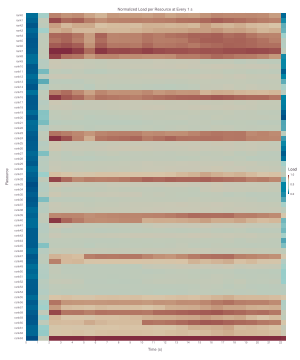

In [268]:
# define size of plot
set_default_plot_size(30cm, 36cm)
# plot heat map of load evolution per resource
load_heatmap(mpi[execution], timestep)

In [269]:
# define how much time (at each end of exec) must be dropped
drop = 1;

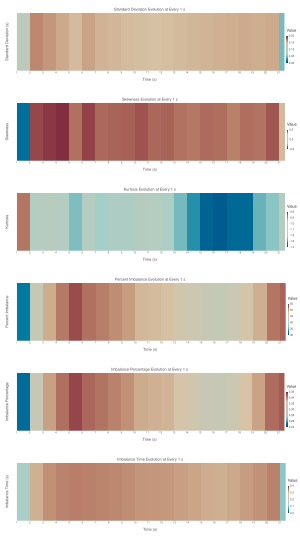

In [270]:
# plots container
plots = Plot[]

# plot metrics heat maps
for f in fs
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end

# define plot size
set_default_plot_size(30cm, length(fs)*9cm)

# draw plots vertically
vstack(plots)

**No Phase**

In [271]:
# define parameters
execution = "no-phase";

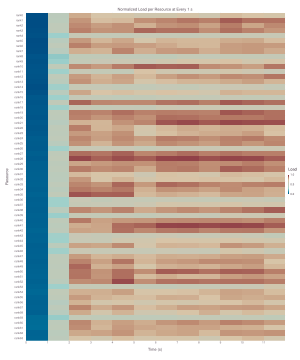

In [272]:
# define size of plot
set_default_plot_size(30cm, 36cm)
# plot heat map of load evolution per resource
load_heatmap(mpi[execution], timestep)

In [273]:
# define how much time (at each end of exec) must be dropped
drop = 1;

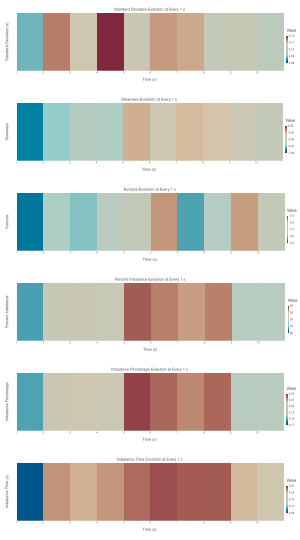

In [274]:
# plots container
plots = Plot[]

# plot metrics heat maps
for f in fs
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end

# define plot size
set_default_plot_size(30cm, length(fs)*9cm)

# draw plots vertically
vstack(plots)

##### `OpenMP`

##### `StarPU`

In [275]:
# evolution grain
timestep = 2;

**Scheduler** `DMDA`, **Block Size** `20`

In [276]:
# define parameters
scheduler = "DMDA";
bsize = 20;

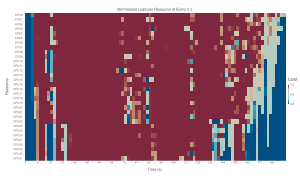

In [277]:
# define size of plot
set_default_plot_size(30cm, 18cm)
# plot heat map of load evolution per resource
load_heatmap(starpu[scheduler][bsize], timestep)

In [278]:
# define how much time (at each end of exec) must be dropped
drop = 10;

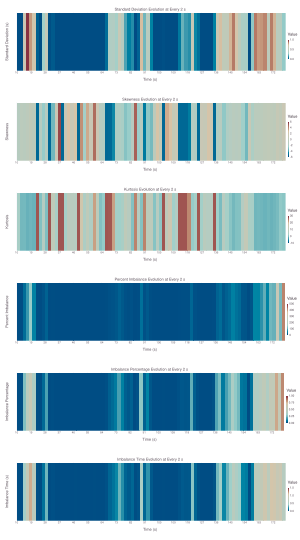

In [279]:
# plots container
plots = Plot[]

# plot metrics heat maps
for f in fs
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end

# define plot size
set_default_plot_size(30cm, length(fs)*9cm)

# draw plots vertically
vstack(plots)

**Scheduler** `DMDA`, **Block Size** `80`

In [280]:
# define parameters
scheduler = "DMDA";
bsize = 80;

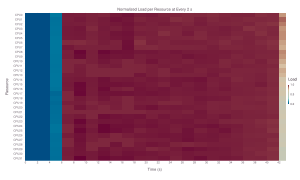

In [281]:
# define size of plot
set_default_plot_size(30cm, 18cm)
# plot heat map of load evolution per resource
load_heatmap(starpu[scheduler][bsize], timestep)

In [282]:
# define how much time (at each end of exec) must be dropped
drop = 4;

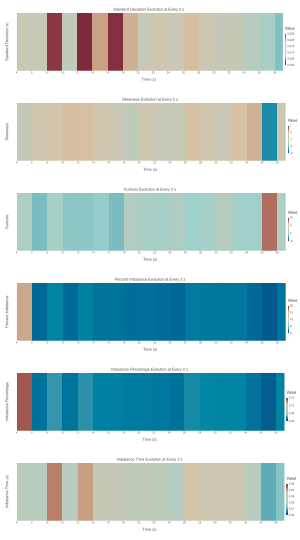

In [283]:
# plots container
plots = Plot[]

# plot metrics heat maps
for f in fs
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end

# define plot size
set_default_plot_size(30cm, length(fs)*9cm)

# draw plots vertically
vstack(plots)

**Scheduler** `DMDAS`, **Block Size** `20`

In [284]:
# define parameters
scheduler = "DMDAS";
bsize = 20;

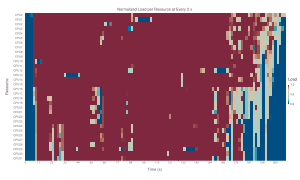

In [285]:
# define size of plot
set_default_plot_size(30cm, 18cm)
# plot heat map of load evolution per resource
load_heatmap(starpu[scheduler][bsize], timestep)

In [286]:
# define how much time (at each end of exec) must be dropped
drop = 10;

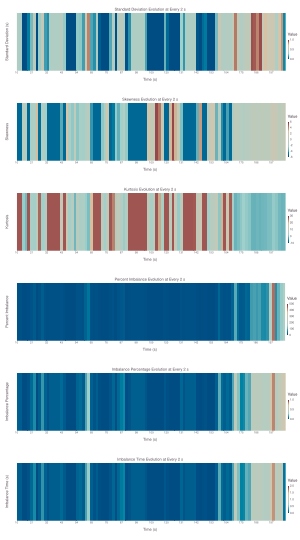

In [287]:
# plots container
plots = Plot[]

# plot metrics heat maps
for f in fs
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end

# define plot size
set_default_plot_size(30cm, length(fs)*9cm)

# draw plots vertically
vstack(plots)

**Scheduler** `DMDAS`, **Block Size** `80`

In [288]:
# define parameters
scheduler = "DMDAS";
bsize = 80;

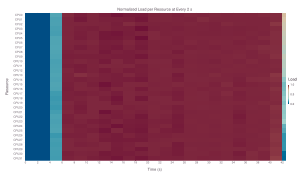

In [289]:
# define size of plot
set_default_plot_size(30cm, 18cm)
# plot heat map of load evolution per resource
load_heatmap(starpu[scheduler][bsize], timestep)

In [290]:
# define how much time (at each end of exec) must be dropped
drop = 4;

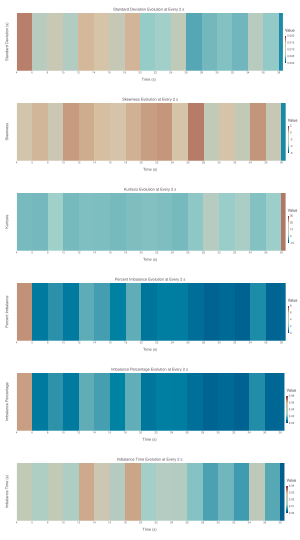

In [291]:
# plots container
plots = Plot[]

for f in fs
    # plot metric heat map
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end

# define plot size
set_default_plot_size(30cm, length(fs)*9cm)

# draw plots vertically
vstack(plots)

#### Metrics: Sensibility

##### `MPI`

In [292]:
# define timesteps
timesteps = [1, 3, 5];

**Blocking**

In [307]:
# define parameters
execution = "blocking";

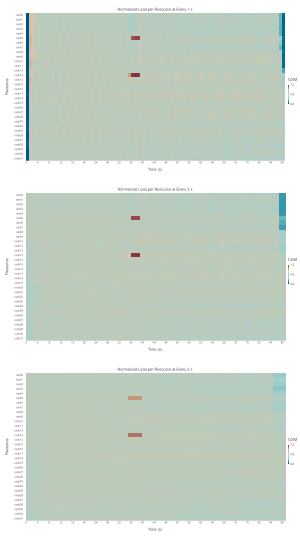

In [308]:
# define size of plot
set_default_plot_size(30cm, length(timesteps)*18cm)
# instantiate plots container
plots = Plot[]
# plot heat map of load evolution per resource for all timesteps
for timestep in timesteps
    push!(plots, load_heatmap(mpi[execution], timestep))
end
# draw plots vertically
vstack(plots)

In [309]:
# define how much time (at each end of exec) must be dropped
drop = 1;

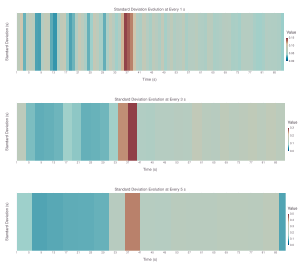

In [310]:
# select corresponding Function to metric
f = std
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

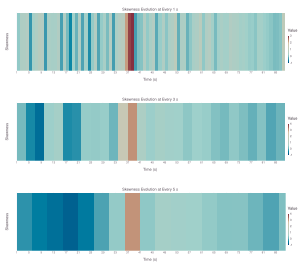

In [311]:
# select corresponding Function to metric
f = skewness
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

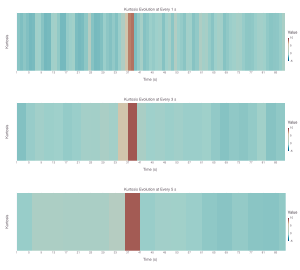

In [312]:
# select corresponding Function to metric
f = kurtosis
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

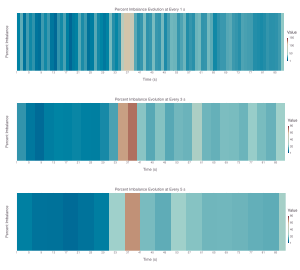

In [313]:
# select corresponding Function to metric
f = pimbalance
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

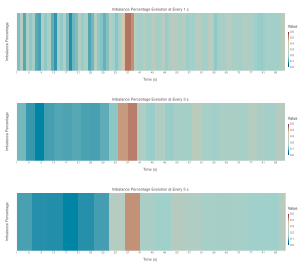

In [314]:
# select corresponding Function to metric
f = imbalancep
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

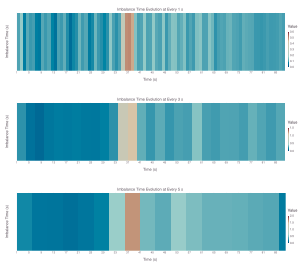

In [315]:
# select corresponding Function to metric
f = imbalancet
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

**Non-blocking**

In [316]:
# define parameters
execution = "non-blocking";

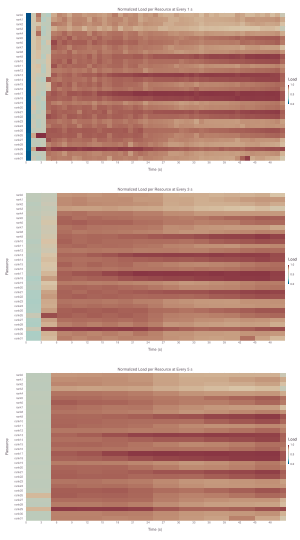

In [317]:
# define size of plot
set_default_plot_size(30cm, length(timesteps)*18cm)
# instantiate plots container
plots = Plot[]
# plot heat map of load evolution per resource for all timesteps
for timestep in timesteps    
    push!(plots, load_heatmap(mpi[execution], timestep))
end
# draw plots vertically
vstack(plots)

In [318]:
# define how much time (at each end of exec) must be dropped
drop = 1;

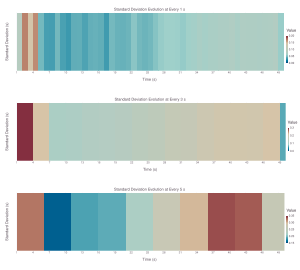

In [319]:
# select corresponding Function to metric
f = std
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

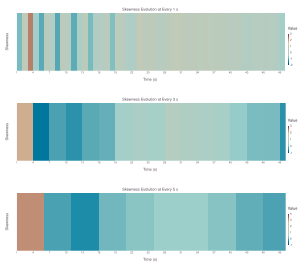

In [320]:
# select corresponding Function to metric
f = skewness
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

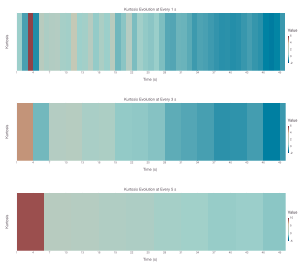

In [321]:
# select corresponding Function to metric
f = kurtosis
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

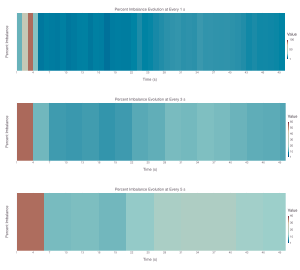

In [322]:
# select corresponding Function to metric
f = pimbalance
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

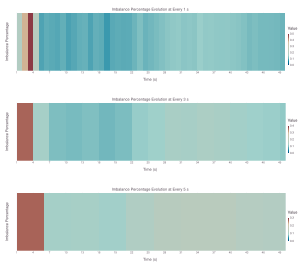

In [323]:
# select corresponding Function to metric
f = imbalancep
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

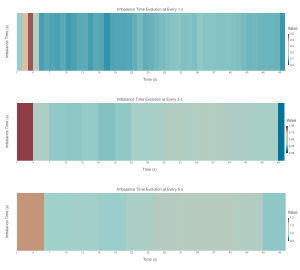

In [324]:
# select corresponding Function to metric
f = imbalancet
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

**Phase**

In [334]:
# define parameters
execution = "phase";

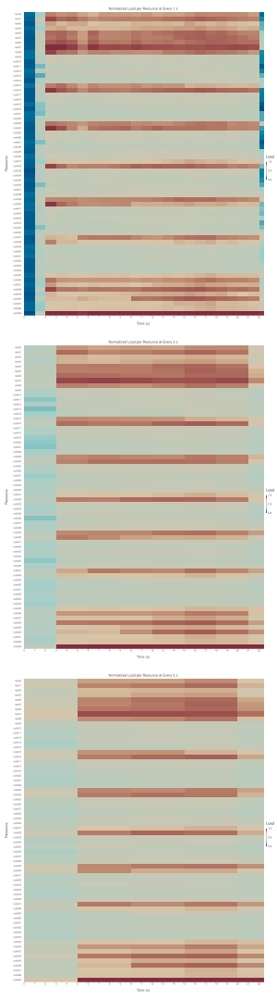

In [335]:
# define size of plot
set_default_plot_size(30cm, length(timesteps)*36cm)
# instantiate plots container
plots = Plot[]
# plot heat map of load evolution per resource for all timesteps
for timestep in timesteps    
    push!(plots, load_heatmap(mpi[execution], timestep))
end
# draw plots vertically
vstack(plots)

In [336]:
# define how much time (at each end of exec) must be dropped
drop = 1;

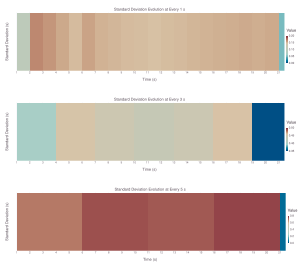

In [337]:
# select corresponding Function to metric
f = std
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

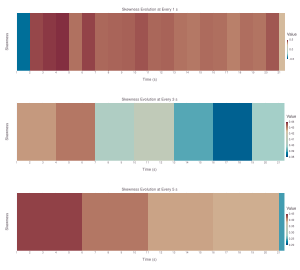

In [338]:
# select corresponding Function to metric
f = skewness
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

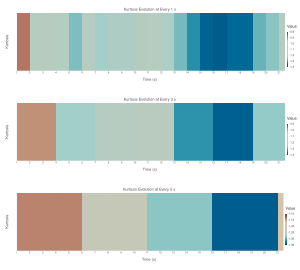

In [339]:
# select corresponding Function to metric
f = kurtosis
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

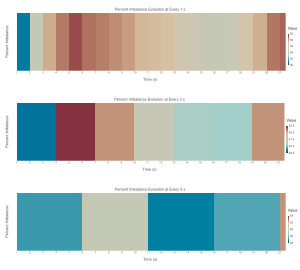

In [340]:
# select corresponding Function to metric
f = pimbalance
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

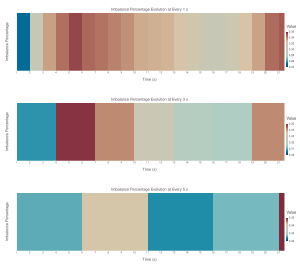

In [341]:
# select corresponding Function to metric
f = imbalancep
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

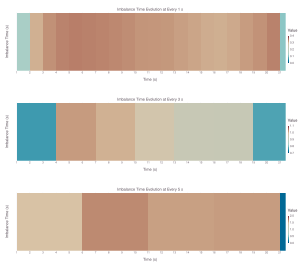

In [342]:
# select corresponding Function to metric
f = imbalancet
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

**No Phase**

In [343]:
# define parameters
execution = "no-phase";

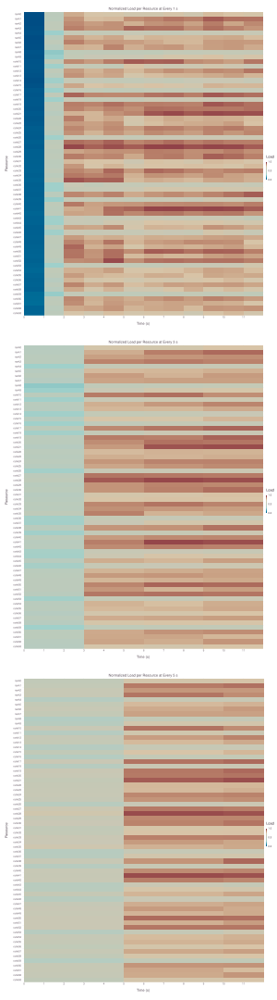

In [344]:
# define size of plot
set_default_plot_size(30cm, length(timesteps)*36cm)
# instantiate plots container
plots = Plot[]
# plot heat map of load evolution per resource for all timesteps
for timestep in timesteps    
    push!(plots, load_heatmap(mpi[execution], timestep))
end
# draw plots vertically
vstack(plots)

In [345]:
# define how much time (at each end of exec) must be dropped
drop = 1;

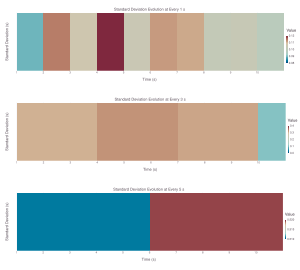

In [346]:
# select corresponding Function to metric
f = std
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

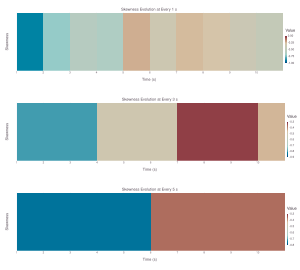

In [347]:
# select corresponding Function to metric
f = skewness
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

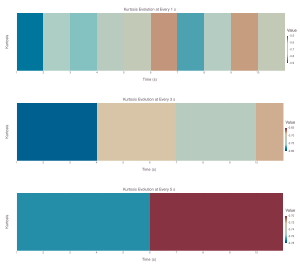

In [348]:
# select corresponding Function to metric
f = kurtosis
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

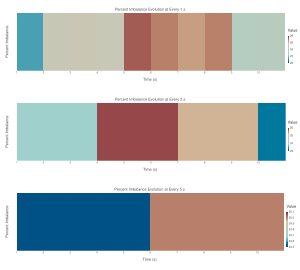

In [349]:
# select corresponding Function to metric
f = pimbalance
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

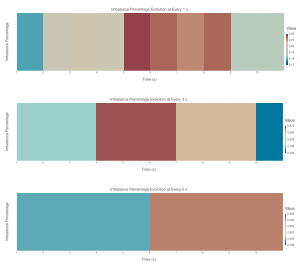

In [350]:
# select corresponding Function to metric
f = imbalancep
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

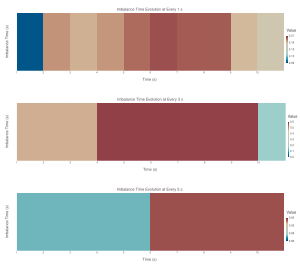

In [351]:
# select corresponding Function to metric
f = imbalancet
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(mpi[execution], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

##### `OpenMP`

##### `StarPU`

In [360]:
# define timesteps
timesteps = [2, 4, 8];

**Scheduler** `DMDA`, **Block Size** `20`

In [359]:
# define parameters
scheduler = "DMDA";
bsize = 20;

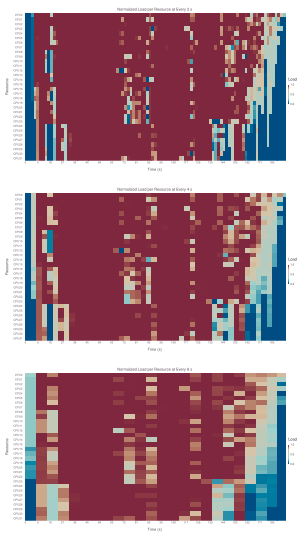

In [356]:
# define size of plot
set_default_plot_size(30cm, length(timesteps)*18cm)
# instantiate plots container
plots = Plot[]
# plot heat map of load evolution per resource for all timesteps
for timestep in timesteps    
    push!(plots, load_heatmap(starpu[scheduler][bsize], timestep))
end
# draw plots vertically
vstack(plots)

In [361]:
# define how much time (at each end of exec) must be dropped
drop = 10;

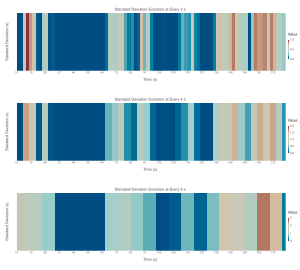

In [362]:
# select corresponding Function to metric
f = std
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

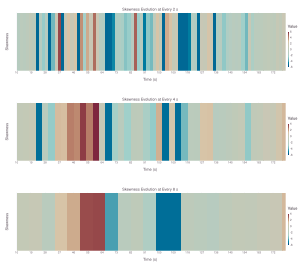

In [363]:
# select corresponding Function to metric
f = skewness
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

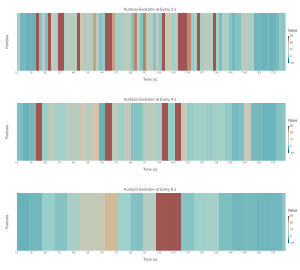

In [364]:
# select corresponding Function to metric
f = kurtosis
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

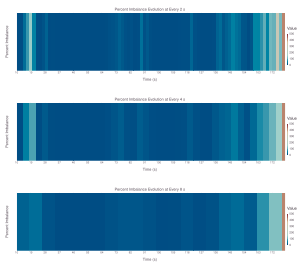

In [365]:
# select corresponding Function to metric
f = pimbalance
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

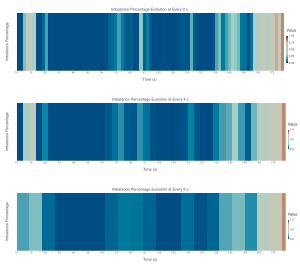

In [366]:
# select corresponding Function to metric
f = imbalancep
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

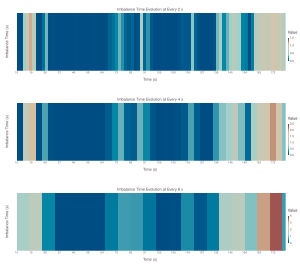

In [367]:
# select corresponding Function to metric
f = imbalancet
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

**Scheduler** `DMDA`, **Block Size** `80`

In [368]:
# define parameters
scheduler = "DMDA";
bsize = 80;

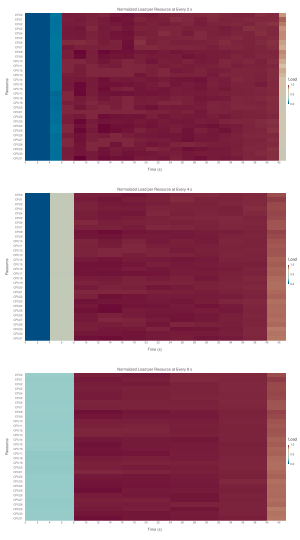

In [369]:
# define size of plot
set_default_plot_size(30cm, length(timesteps)*18cm)
# instantiate plots container
plots = Plot[]
# plot heat map of load evolution per resource for all timesteps
for timestep in timesteps    
    push!(plots, load_heatmap(starpu[scheduler][bsize], timestep))
end
# draw plots vertically
vstack(plots)

In [370]:
# define how much time (at each end of exec) must be dropped
drop = 4;

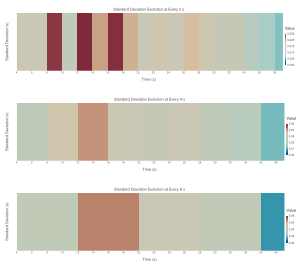

In [371]:
# select corresponding Function to metric
f = std
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

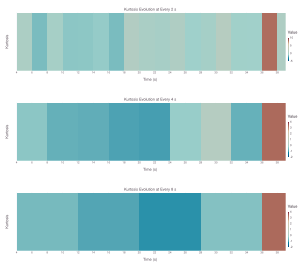

In [372]:
# select corresponding Function to metric
f = kurtosis
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

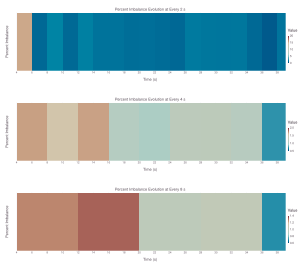

In [373]:
# select corresponding Function to metric
f = pimbalance
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

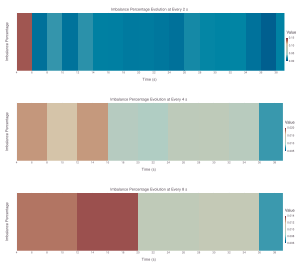

In [374]:
# select corresponding Function to metric
f = imbalancep
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

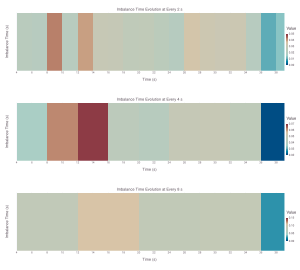

In [375]:
# select corresponding Function to metric
f = imbalancet
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

**Scheduler** `DMDAS`, **Block Size** `20`

In [376]:
# define parameters
scheduler = "DMDAS";
bsize = 20;

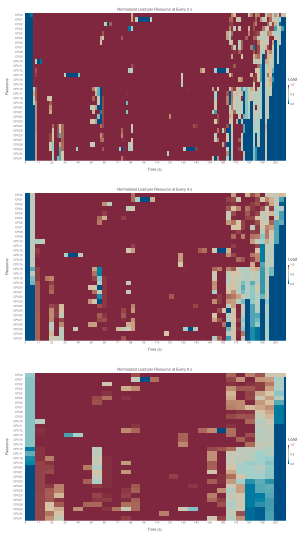

In [377]:
# define size of plot
set_default_plot_size(30cm, length(timesteps)*18cm)
# instantiate plots container
plots = Plot[]
# plot heat map of load evolution per resource for all timesteps
for timestep in timesteps    
    push!(plots, load_heatmap(starpu[scheduler][bsize], timestep))
end
# draw plots vertically
vstack(plots)

In [378]:
# define how much time (at each end of exec) must be dropped
drop = 10;

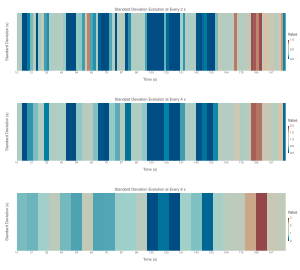

In [379]:
# select corresponding Function to metric
f = std
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

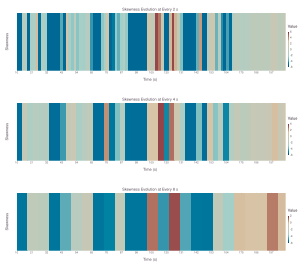

In [380]:
# select corresponding Function to metric
f = skewness
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

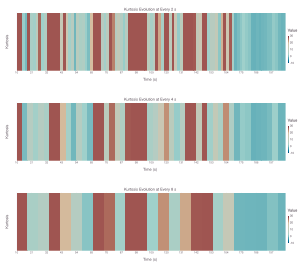

In [381]:
# select corresponding Function to metric
f = kurtosis
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

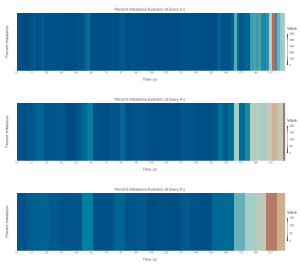

In [382]:
# select corresponding Function to metric
f = pimbalance
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

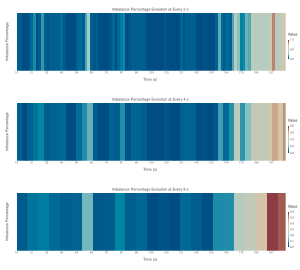

In [383]:
# select corresponding Function to metric
f = imbalancep
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

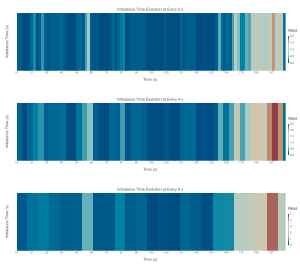

In [384]:
# select corresponding Function to metric
f = imbalancet
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

**Scheduler** `DMDAS`, **Block Size** `80`

In [390]:
# define parameters
scheduler = "DMDAS";
bsize = 80;

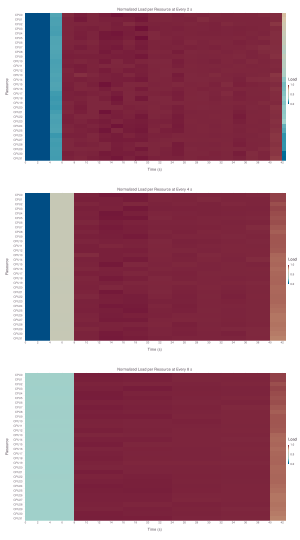

In [391]:
# define size of plot
set_default_plot_size(30cm, length(timesteps)*18cm)
# instantiate plots container
plots = Plot[]
# plot heat map of load evolution per resource for all timesteps
for timestep in timesteps    
    push!(plots, load_heatmap(starpu[scheduler][bsize], timestep))
end
# draw plots vertically
vstack(plots)

In [392]:
# define how much time (at each end of exec) must be dropped
drop = 4;

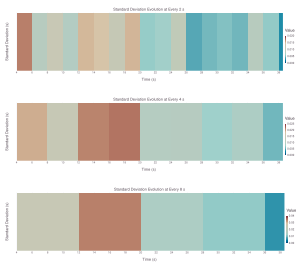

In [393]:
# select corresponding Function to metric
f = std
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

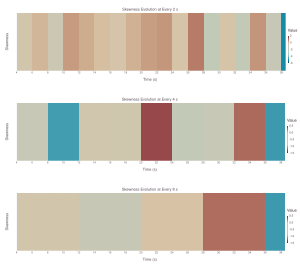

In [394]:
# select corresponding Function to metric
f = skewness
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

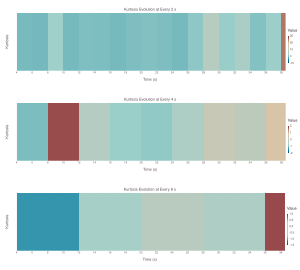

In [395]:
# select corresponding Function to metric
f = kurtosis
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

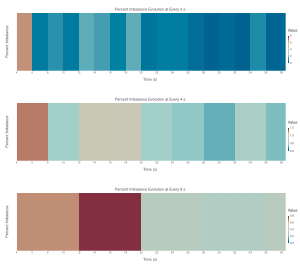

In [396]:
# select corresponding Function to metric
f = pimbalance
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

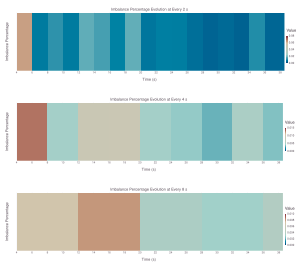

In [397]:
# select corresponding Function to metric
f = imbalancep
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)

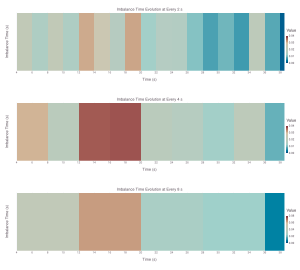

In [398]:
# select corresponding Function to metric
f = imbalancet
# define plot size
set_default_plot_size(30cm, length(timesteps)*9cm)
# instantiate plots container
plots = Plot[]
# plot metric heat map for all timesteps
for timestep in timesteps
    push!(plots, metric_heatmap(starpu[scheduler][bsize], f, timestep, drop))
end
# draw heat maps vertically
vstack(plots)